In [1]:
import os
import copy
from typing import Dict, List

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

import torch
from torch.utils.data import DataLoader

from evaluate import evaluate, save_predictions, calculate_metrics
from metrics import calculate_dtw_distances, calculate_wasserstein_distance
from utils import create_spectrogram,create_combined_spectrogram

Importing the dtw module. When using in academic works please cite:
  T. Giorgino. Computing and Visualizing Dynamic Time Warping Alignments in R: The dtw Package.
  J. Stat. Soft., doi:10.18637/jss.v031.i07.



In [2]:
test_csv_path = "../data/val_data_stg7_clipped.csv"
#test_csv_path = "../data/for_testing_100.csv"

In [3]:
wavelengths = np.load('../data/wavelengths.npy')

## EDM

### Dropout testing


==== Evaluating model: edm_bs16_do10_cgt20_cg3_ns30_lr1e-3_0_e40_ed999 (edm) ====


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:33<00:00,  1.14it/s]


Predictions saved to predictions/edm_bs16_do10_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/preds_epoch40_cfg3.csv
MSE error: 3943.168701
Mean Wasserstein Distance: 22.164360
Mean DTW Distance: 12341.430215


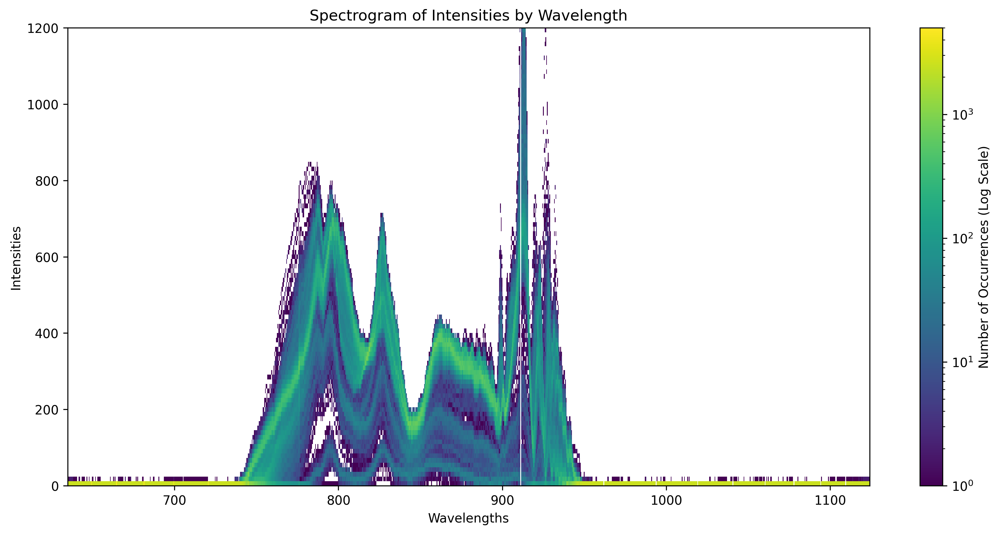

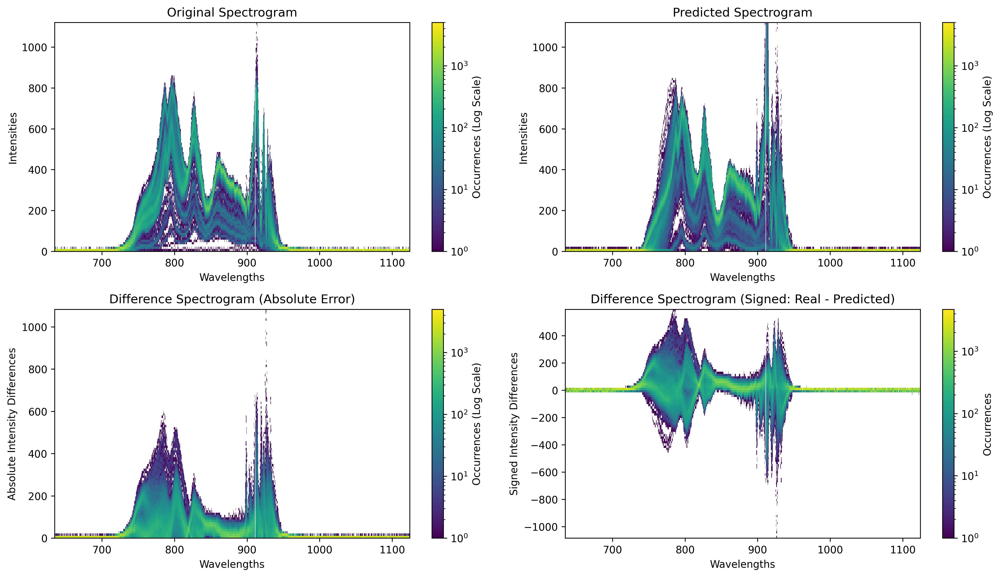

In [5]:
model_name = "edm_bs16_do10_cgt20_cg3_ns30_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "edm"

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

# Run evaluation
x_real, cond_vectors, predictions = evaluate(
    device="cuda:0",
    test_csv_path=test_csv_path,
    model_path=model_path,
    n_samples=1,
    s_type=s_type,
    cfg_scale=3,
    noise_steps=30,
)

# Save predictions
predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg3.csv")
save_predictions(x_real, cond_vectors, predictions, predictions_path)

# Compute metrics
calculate_metrics(x_real, predictions)

create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
create_combined_spectrogram(wavelengths, 
                        x_real, 
                        predictions)

### CFG scale testing


==== Evaluating model: edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999 (edm) ====

--> CFG Scale: -1


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [18:53<00:00,  2.20it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg-1.csv
MSE error: 2640.574707
Mean Wasserstein Distance: 20.130554
Mean DTW Distance: 11011.390709


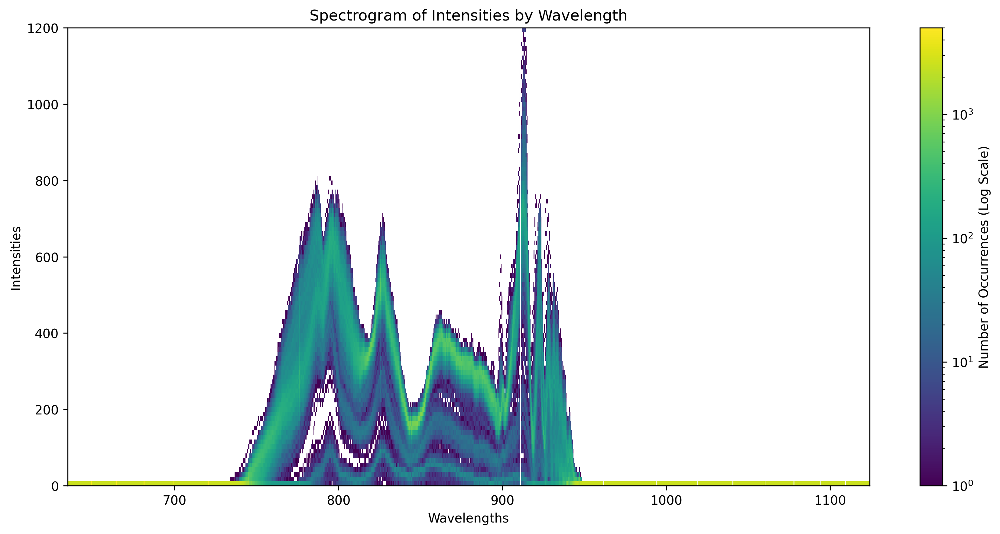

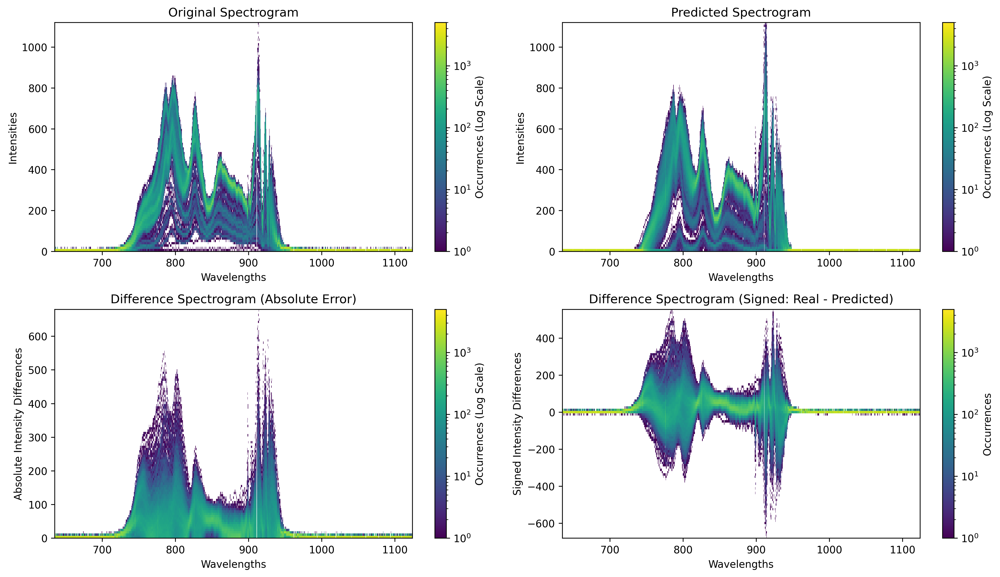


--> CFG Scale: 0


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:58<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg0.csv
MSE error: 16932.410156
Mean Wasserstein Distance: 41.668771
Mean DTW Distance: 36597.115692


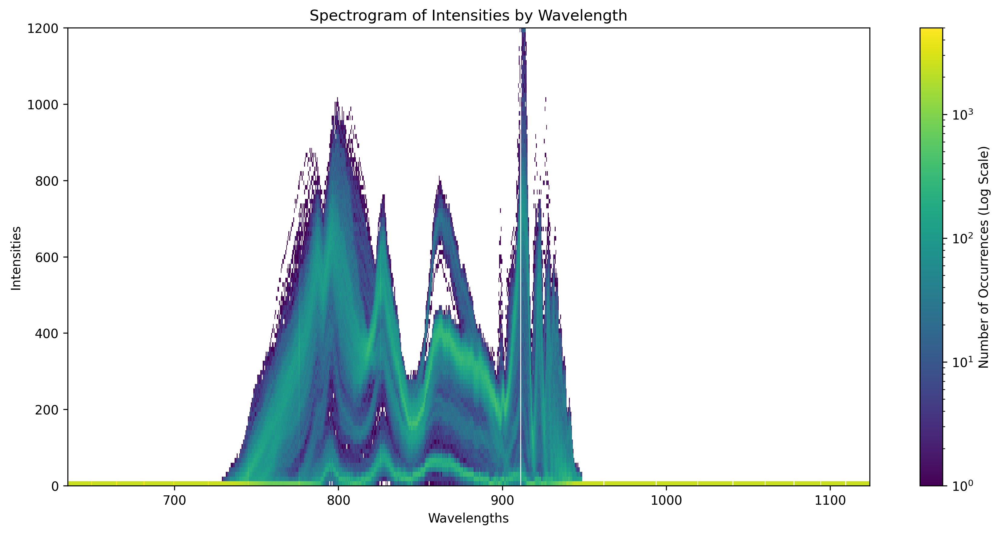

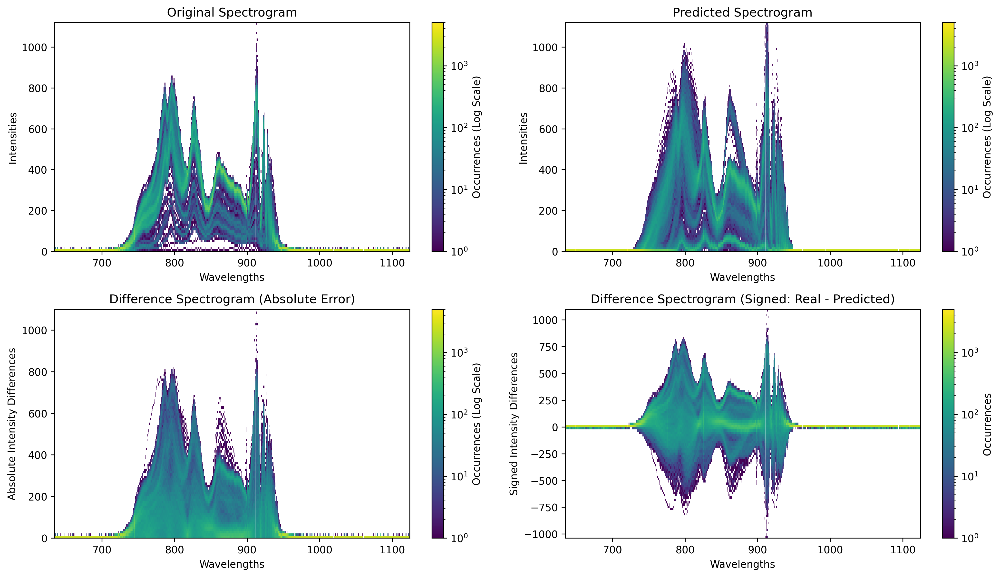


--> CFG Scale: 1


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:02<00:00,  1.12it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg1.csv
MSE error: 2590.897705
Mean Wasserstein Distance: 20.261788
Mean DTW Distance: 10965.477062


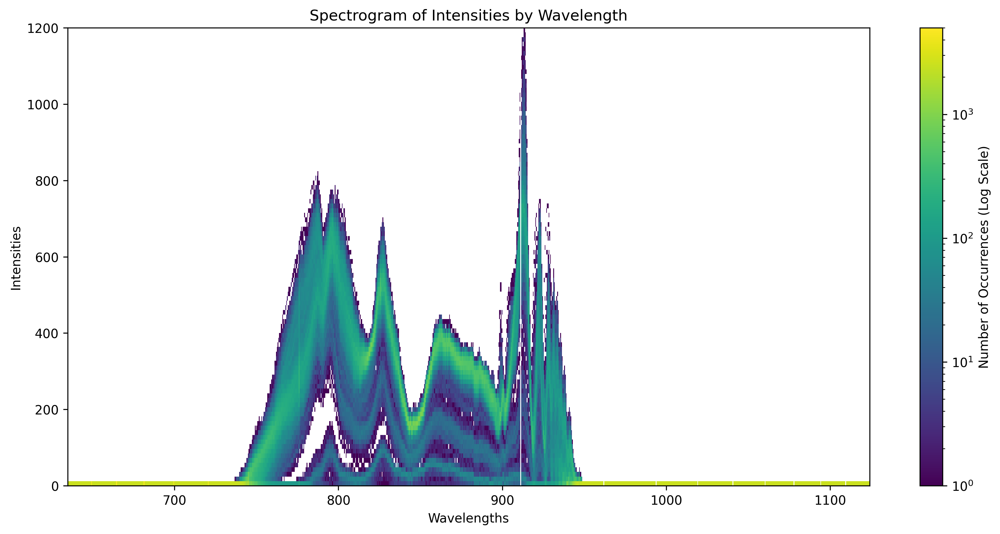

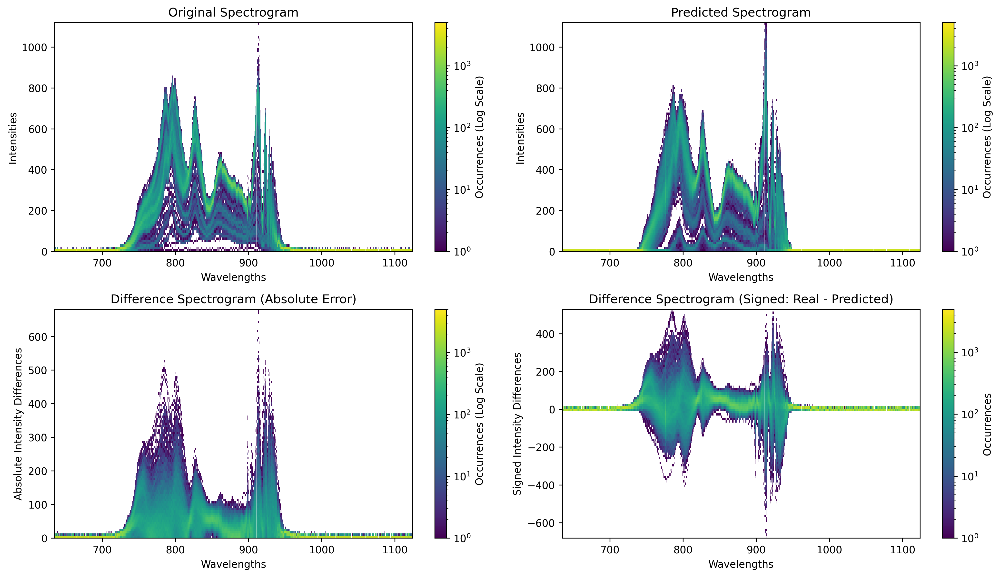


--> CFG Scale: 2


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:01<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg2.csv
MSE error: 2403.202881
Mean Wasserstein Distance: 20.577683
Mean DTW Distance: 10695.007472


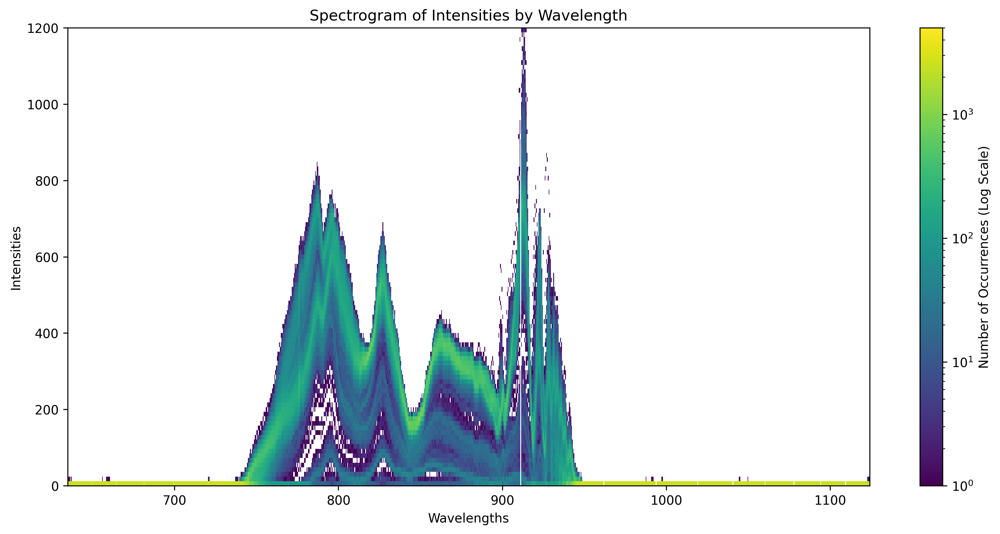

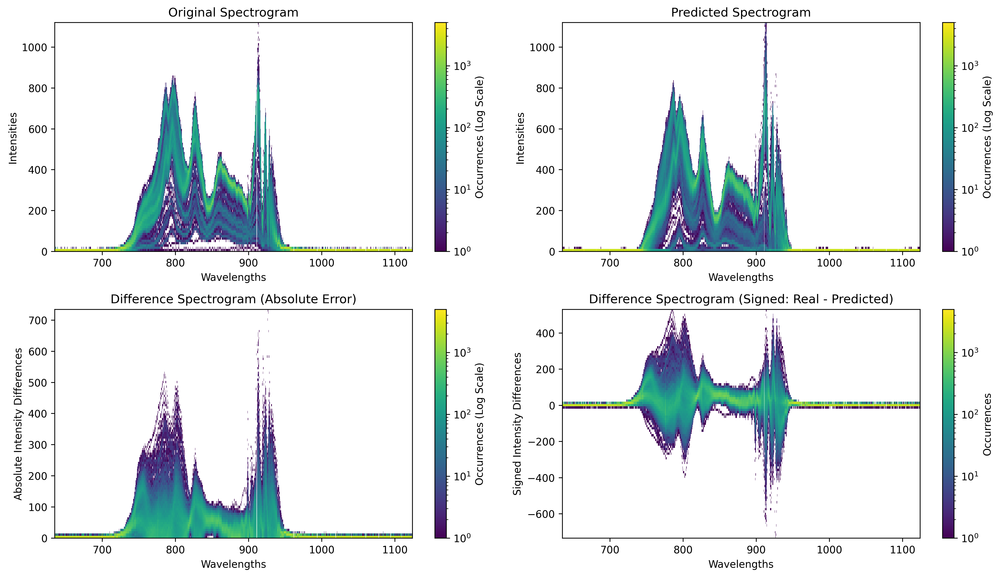


--> CFG Scale: 3


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:53<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg3.csv
MSE error: 2403.053711
Mean Wasserstein Distance: 21.050851
Mean DTW Distance: 10704.635161


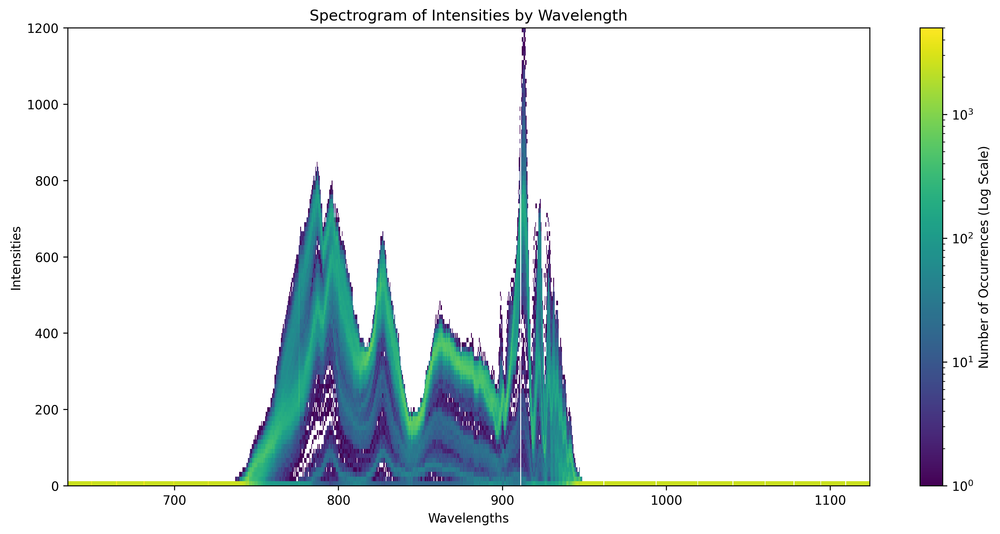

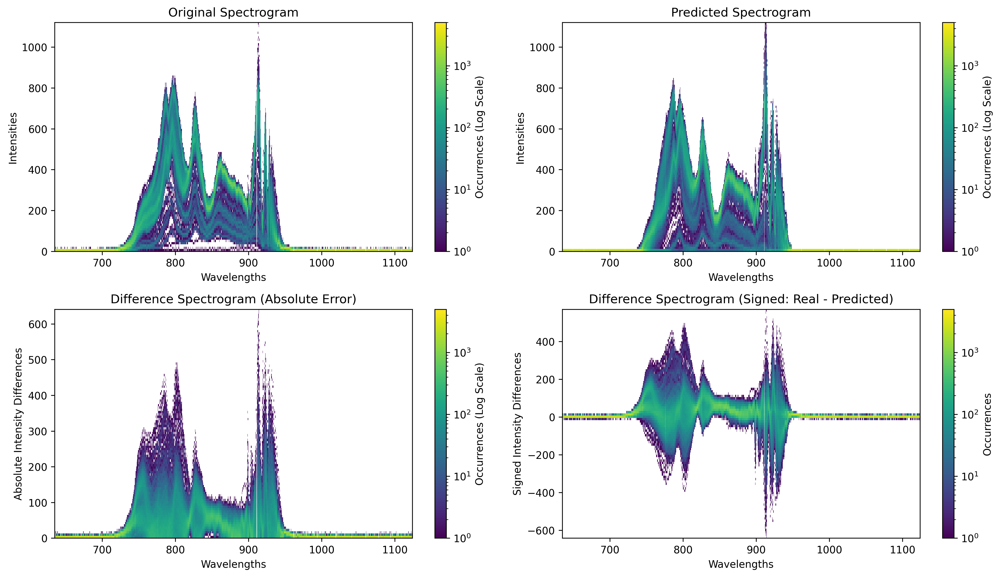


--> CFG Scale: 4


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:57<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg4.csv
MSE error: 2436.679443
Mean Wasserstein Distance: 21.415680
Mean DTW Distance: 10791.062377


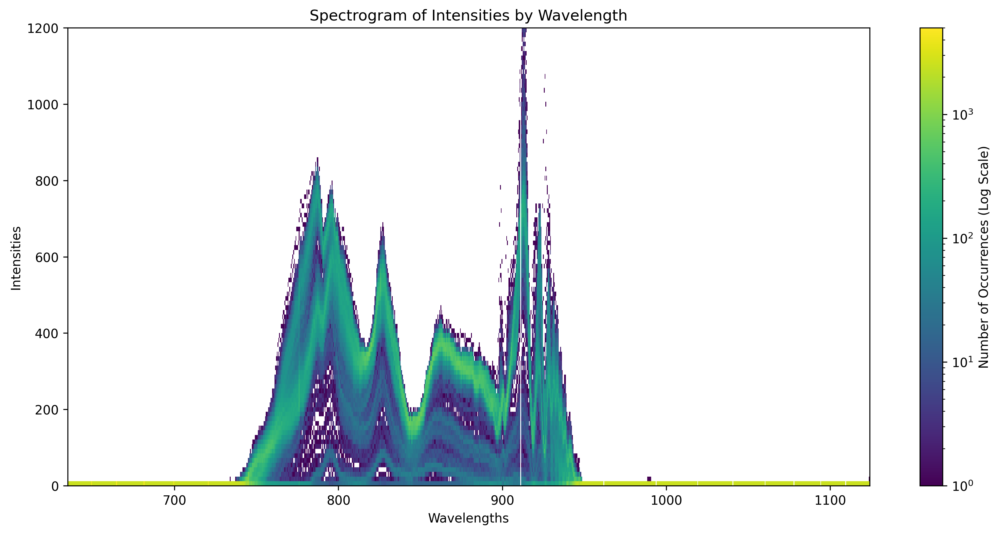

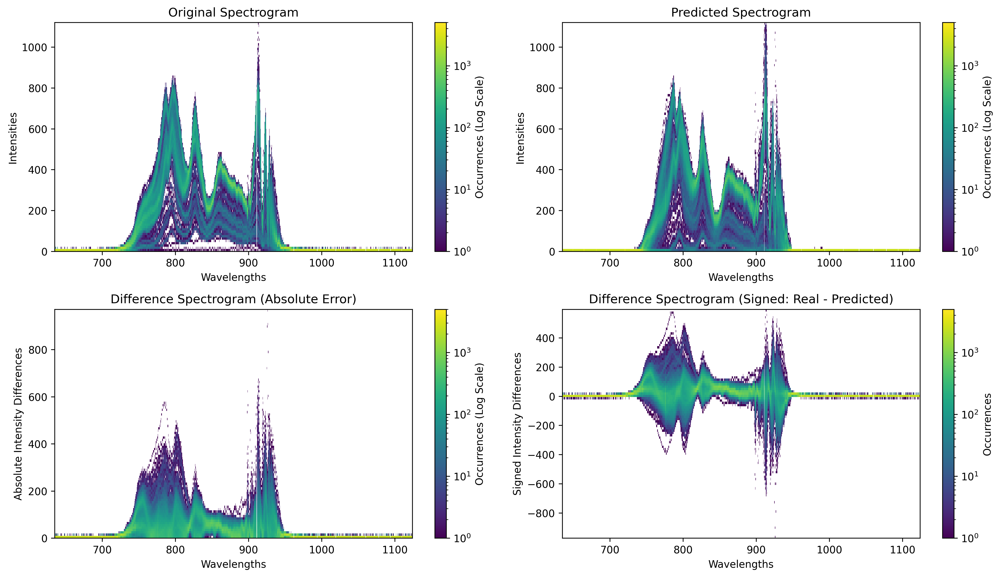


--> CFG Scale: 5


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:00<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg5.csv
MSE error: 2407.574707
Mean Wasserstein Distance: 21.519386
Mean DTW Distance: 10810.078220


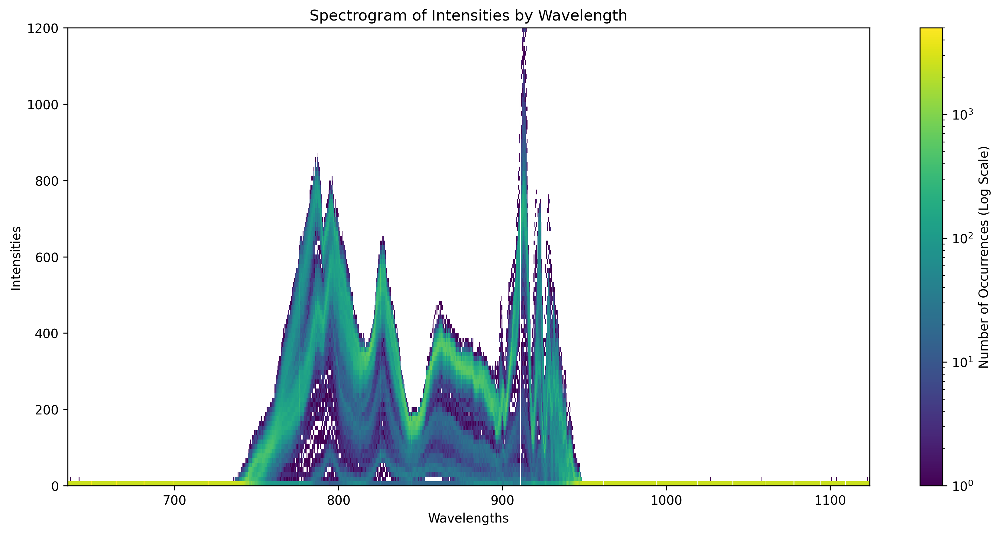

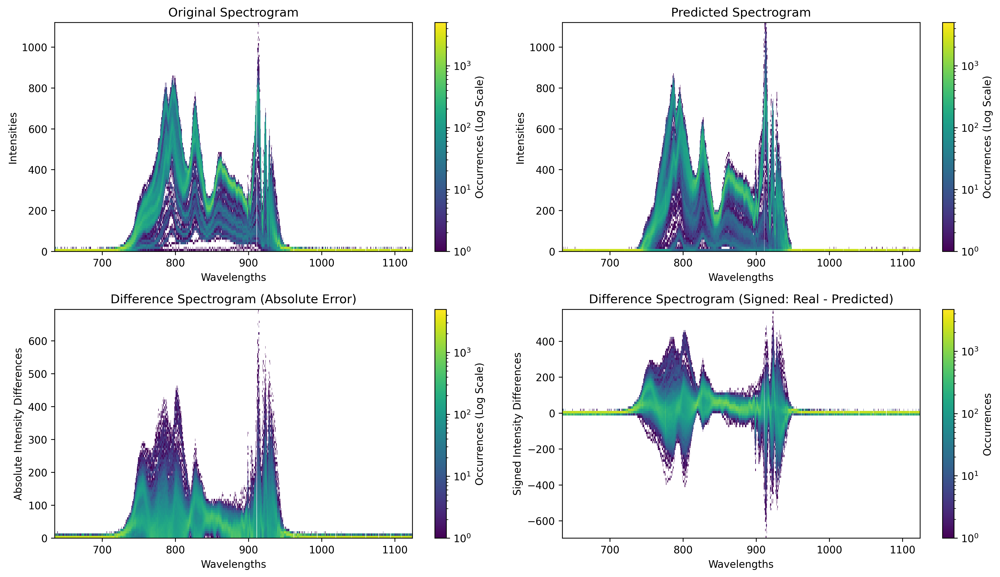


--> CFG Scale: 6


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:58<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg6.csv
MSE error: 2444.235107
Mean Wasserstein Distance: 21.821113
Mean DTW Distance: 10896.816089


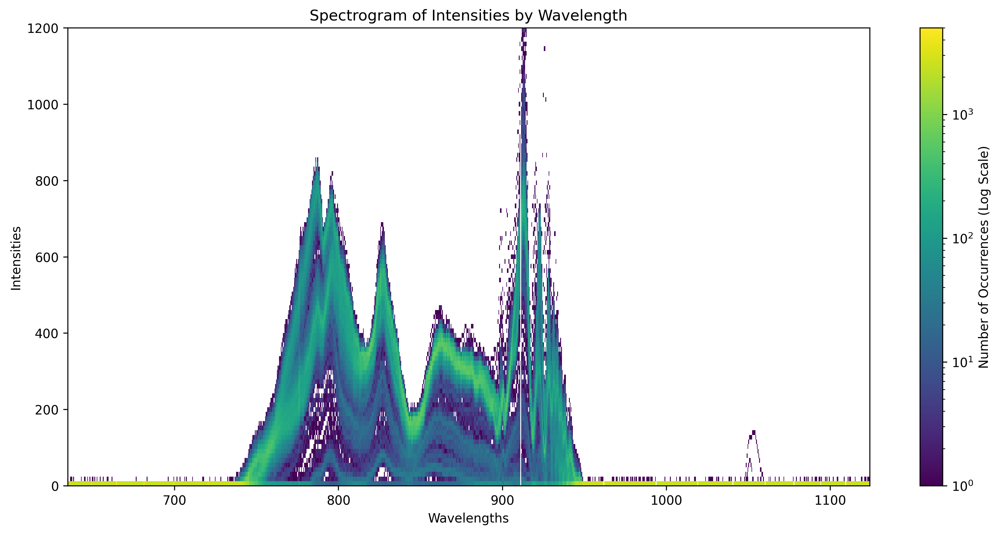

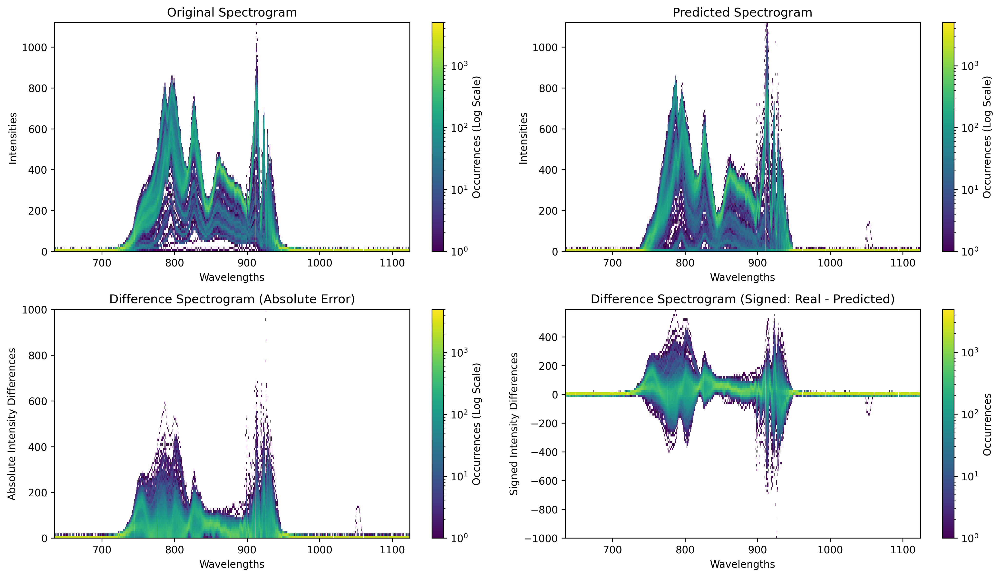


--> CFG Scale: 7


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [36:58<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg7.csv
MSE error: 2466.409180
Mean Wasserstein Distance: 22.033790
Mean DTW Distance: 10989.405060


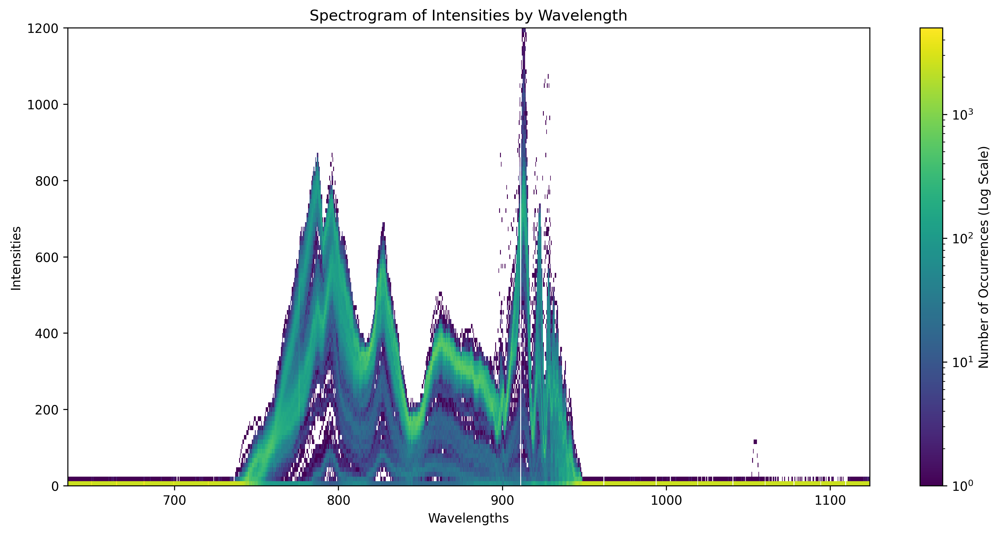

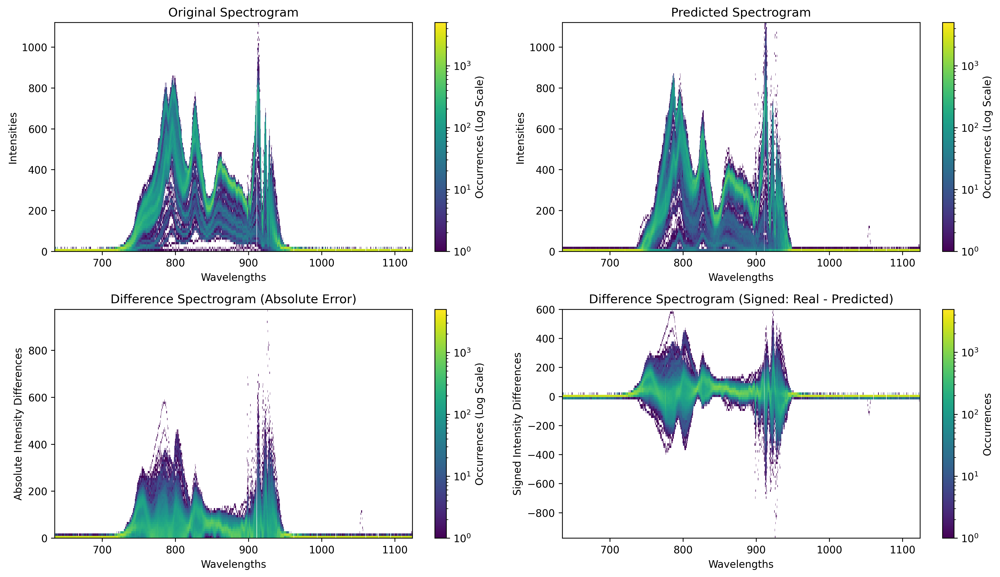


--> CFG Scale: 8


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:03<00:00,  1.12it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg8.csv
MSE error: 2544.022461
Mean Wasserstein Distance: 22.274240
Mean DTW Distance: 11154.684704


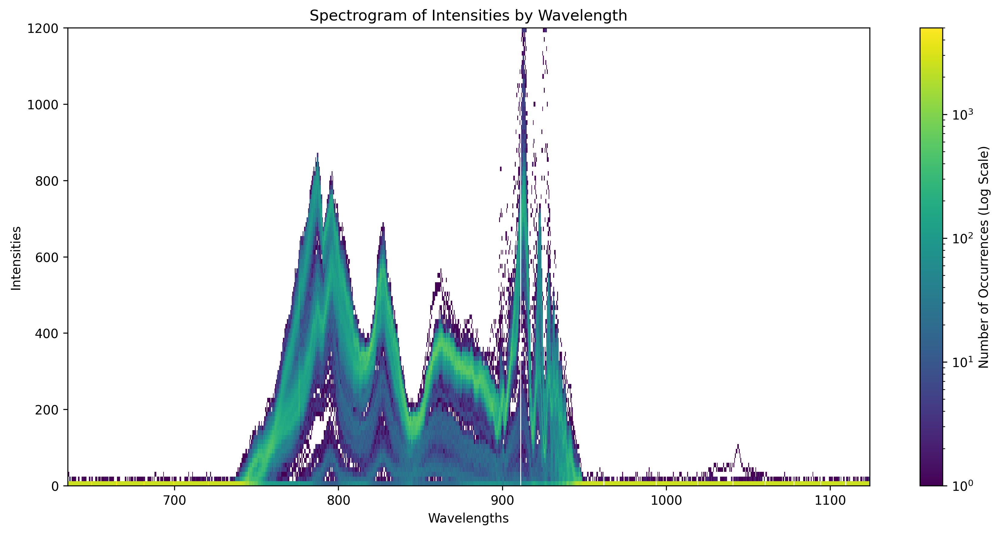

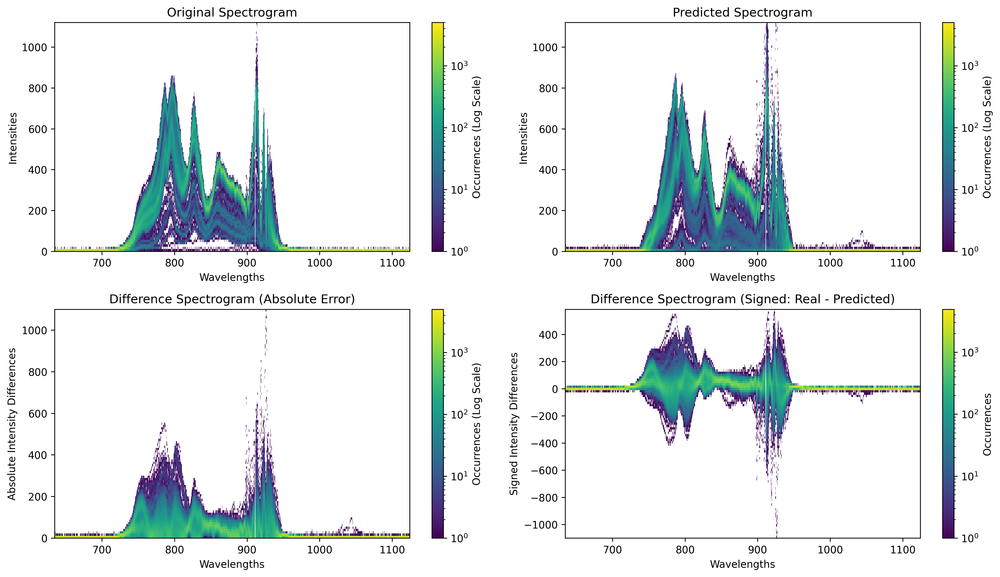


--> CFG Scale: 9


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:07<00:00,  1.12it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg9.csv
MSE error: 2583.701904
Mean Wasserstein Distance: 22.694035
Mean DTW Distance: 11285.609045


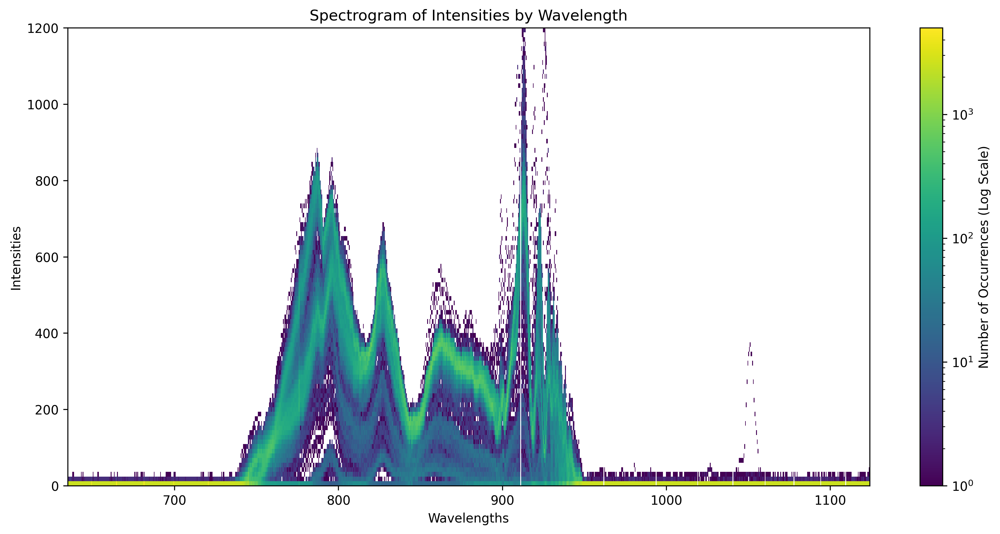

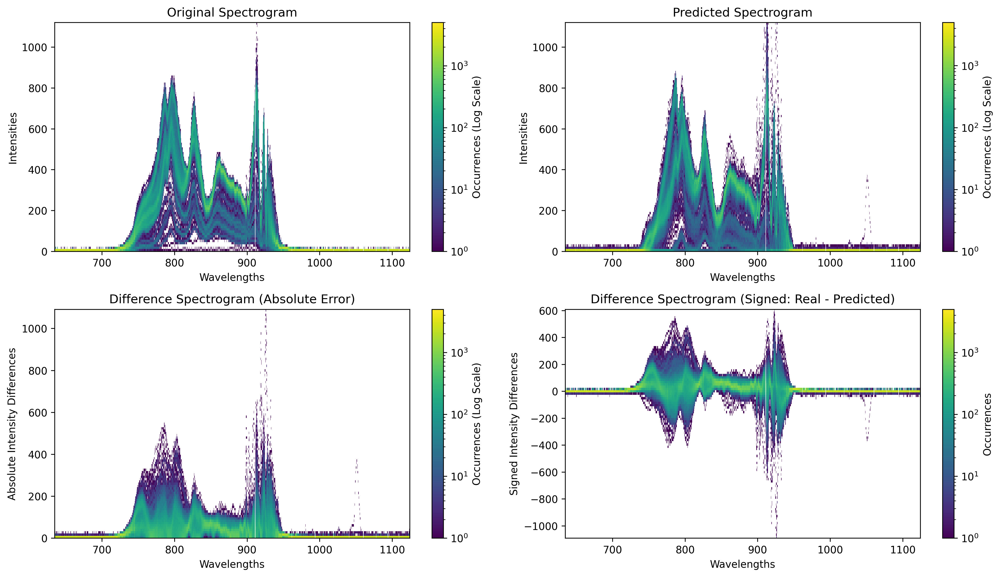


--> CFG Scale: 10


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [37:00<00:00,  1.13it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg10.csv
MSE error: 2650.787354
Mean Wasserstein Distance: 23.051227
Mean DTW Distance: 11481.719195


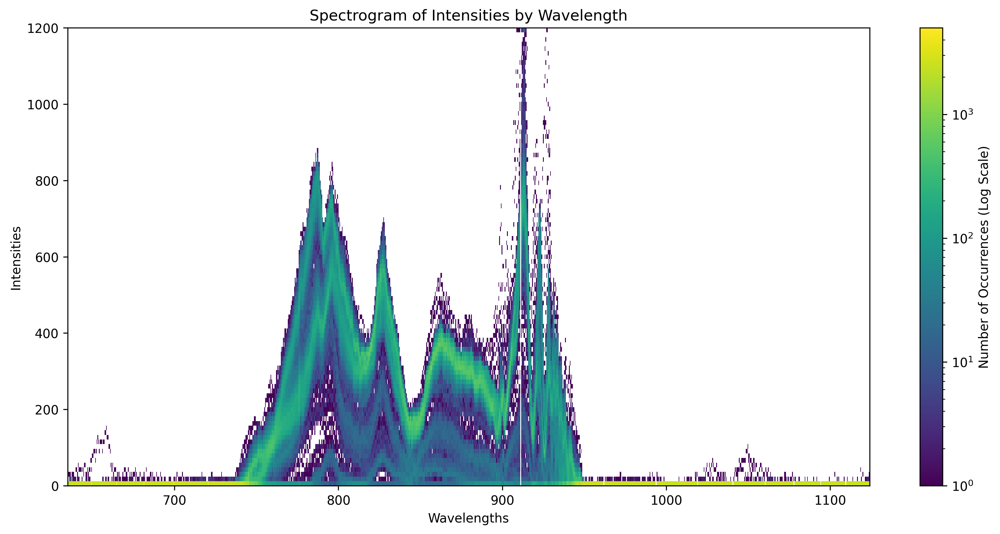

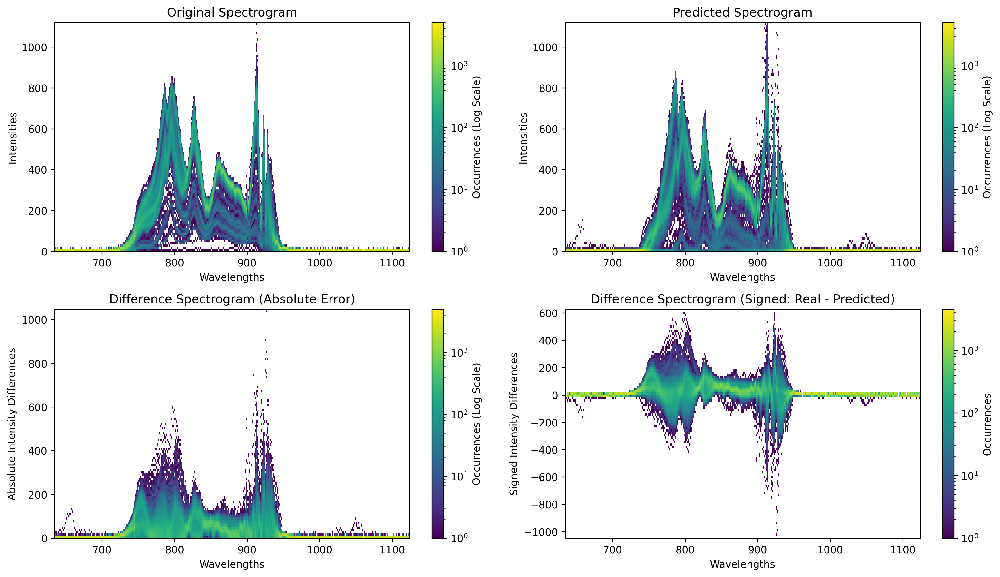

In [4]:
model_name = "edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "edm"
cfg_scales = [-1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for cfg_scale in cfg_scales:
    print(f"\n--> CFG Scale: {cfg_scale}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=cfg_scale,
        noise_steps=30,
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, "new", f"preds_epoch{epoch}_cfg{cfg_scale}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)

### Noise steps


==== Evaluating model: edm_bs16_do0_cgt20_cg3_ns30_lr1e-3_0_e40_ed999 (edm) ====

--> ns: 10


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [11:58<00:00,  3.48it/s]


Predictions saved to predictions/edm_bs16_do0_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/preds_epoch40_cfg2_ns10.csv
MSE error: 2436.778809
Mean Wasserstein Distance: 16.538298
Mean DTW Distance: 10221.831025


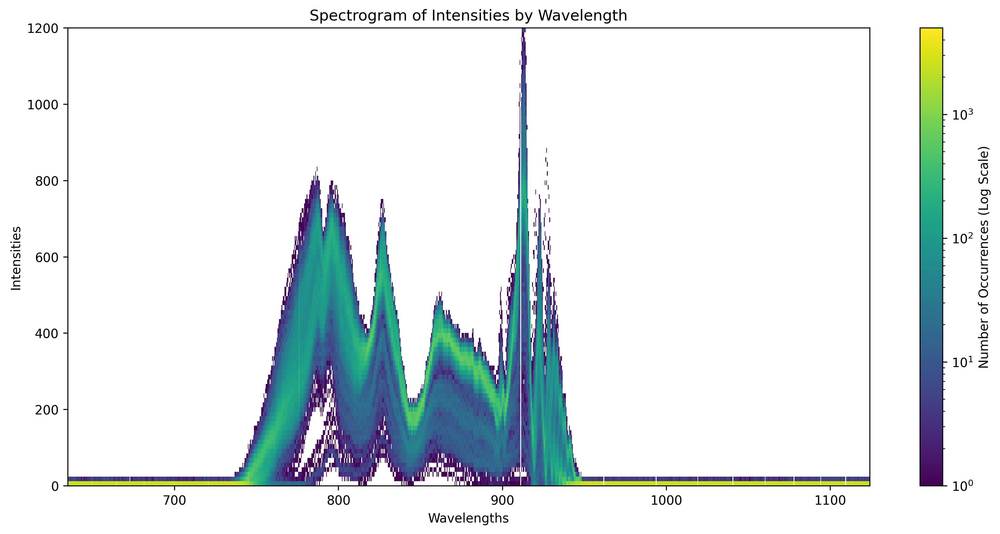

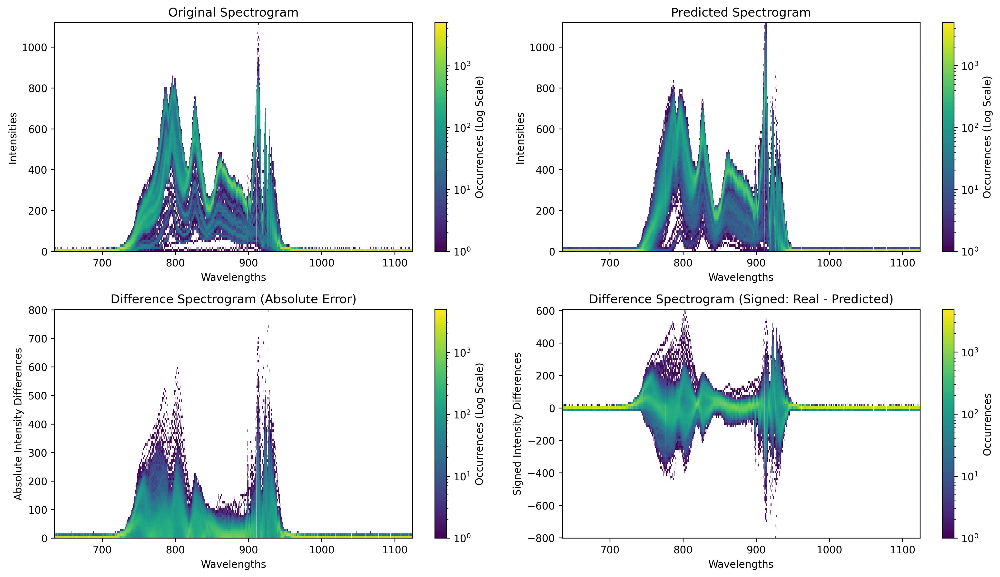


--> ns: 20


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [24:24<00:00,  1.71it/s]


Predictions saved to predictions/edm_bs16_do0_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/preds_epoch40_cfg2_ns20.csv
MSE error: 2312.690430
Mean Wasserstein Distance: 16.676519
Mean DTW Distance: 9725.680485


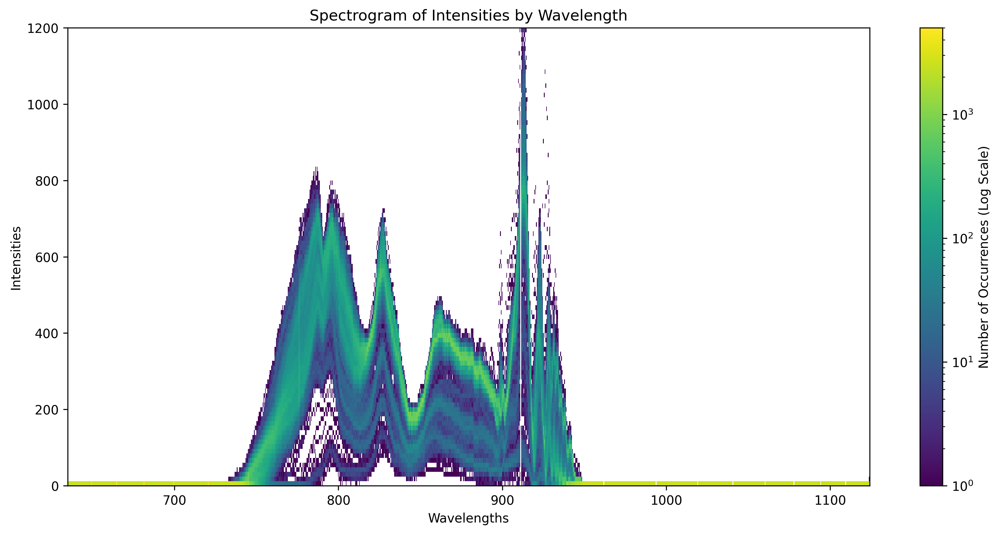

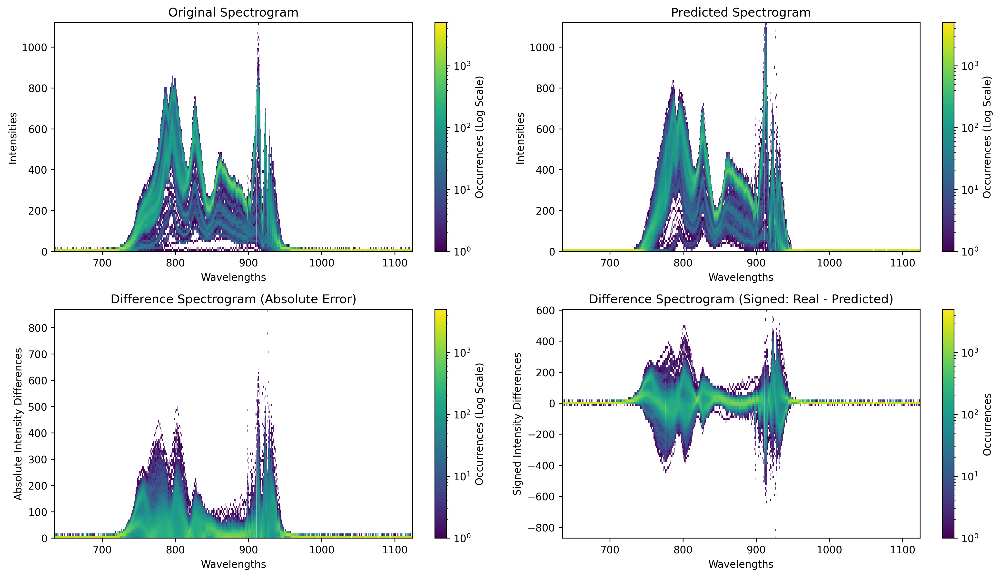

In [4]:
model_name = "edm_bs16_do0_cgt20_cg3_ns30_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "edm"
noise_steps = [10, 20]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for ns in noise_steps:
    print(f"\n--> ns: {ns}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=2,
        noise_steps=ns,
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg2_ns{ns}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)


==== Evaluating model: edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999 (edm) ====

--> ns: 10


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [12:02<00:00,  3.46it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg3_ns10.csv
MSE error: 2974.348389
Mean Wasserstein Distance: 20.484346
Mean DTW Distance: 12164.775033


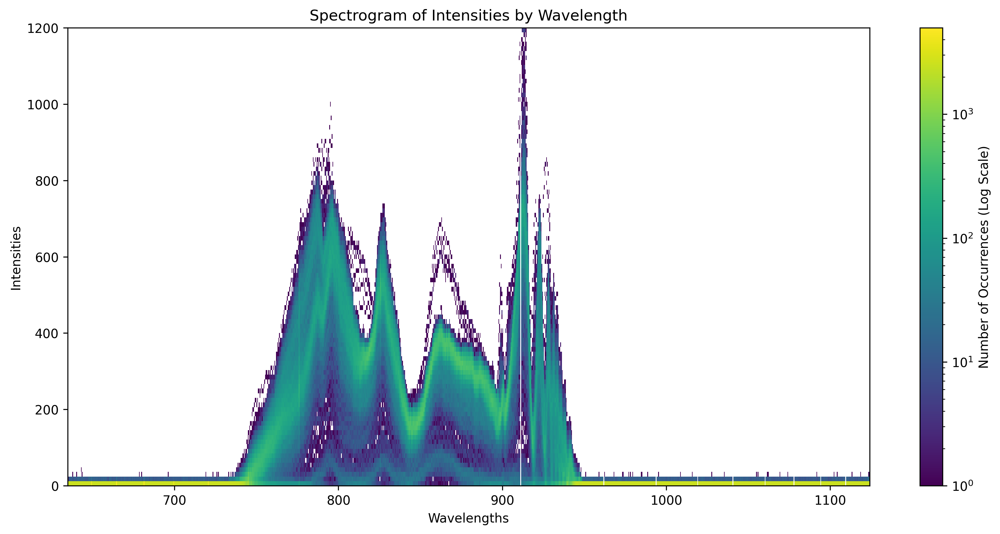

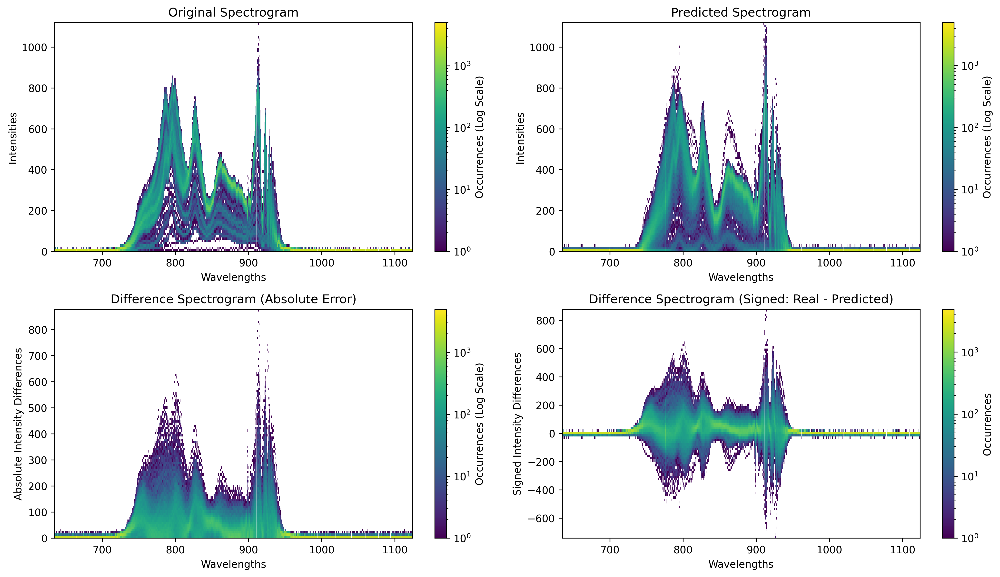


--> ns: 20


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [24:30<00:00,  1.70it/s]


Predictions saved to predictions/edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999/new/preds_epoch40_cfg3_ns20.csv
MSE error: 2384.850098
Mean Wasserstein Distance: 20.927366
Mean DTW Distance: 10675.590779


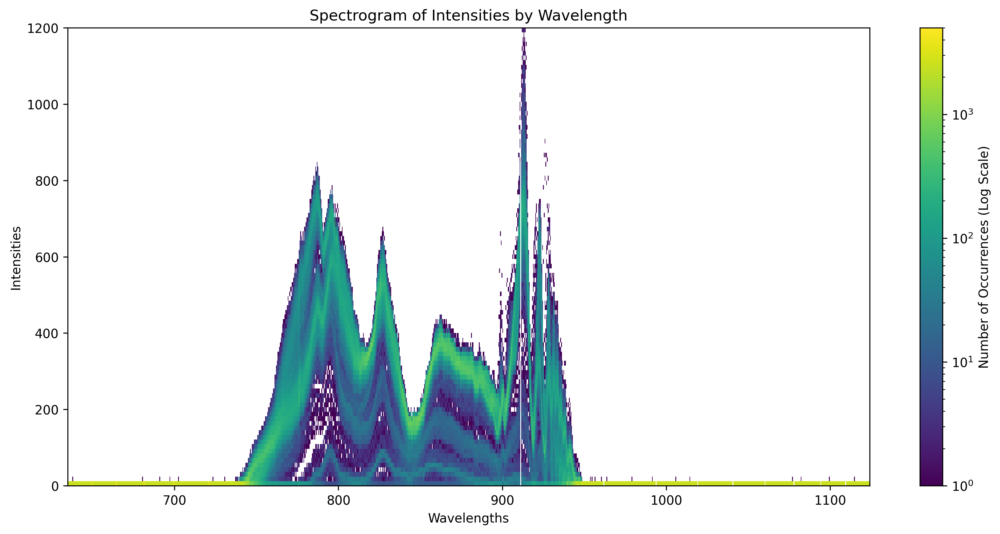

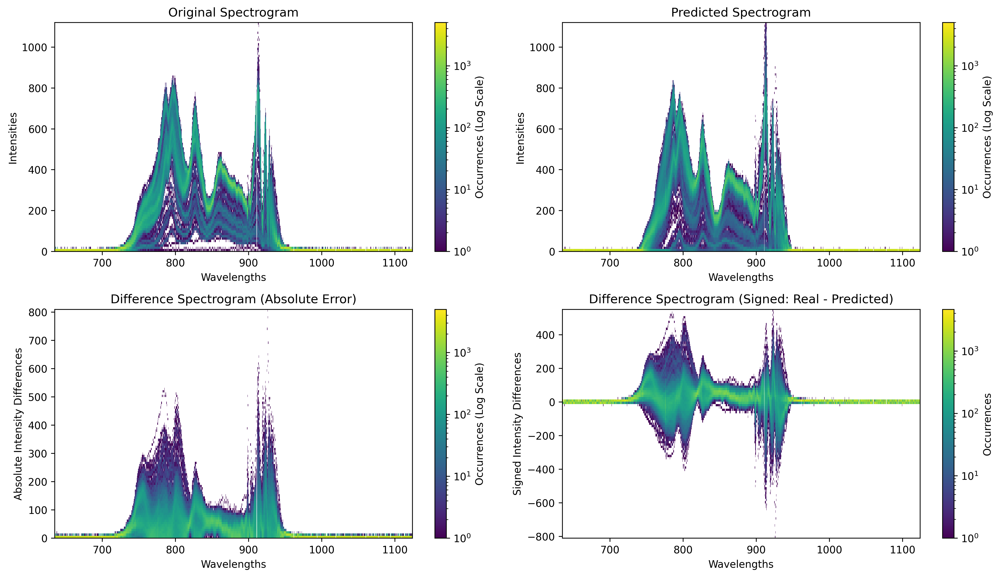

In [4]:
model_name = "edm_bs16_do20_cgt20_cg3_ns30_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "edm"
noise_steps = [10, 20]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for ns in noise_steps:
    print(f"\n--> ns: {ns}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=3,
        noise_steps=ns,
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, "new", f"preds_epoch{epoch}_cfg3_ns{ns}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)

## DDIM

### Dropout


==== Evaluating model: ddim_bs16_do0_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999 (ddim) ====


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [30:41<00:00,  1.36it/s]


Predictions saved to predictions/ddim_bs16_do0_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg3.csv
MSE error: 5948.080566
Mean Wasserstein Distance: 26.761544
Mean DTW Distance: 15516.514184


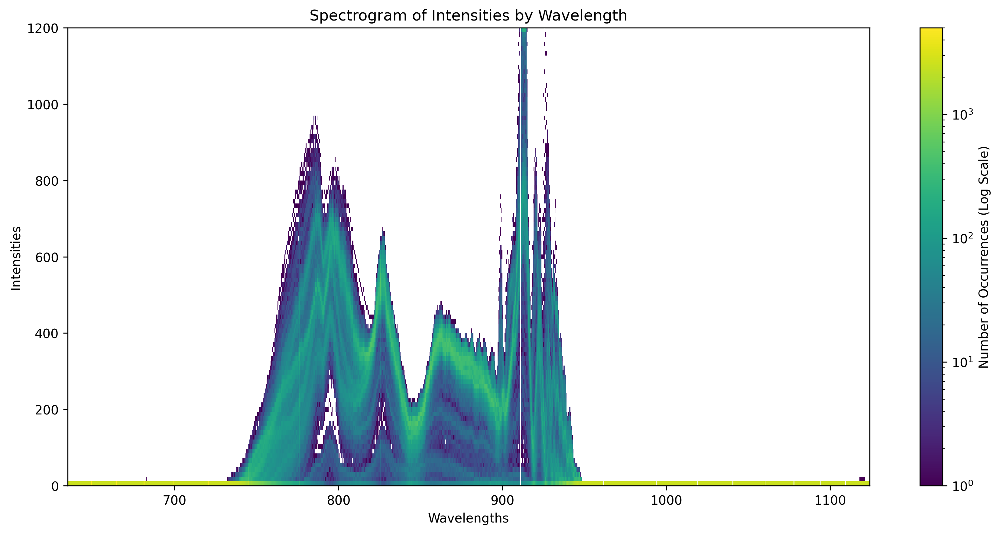

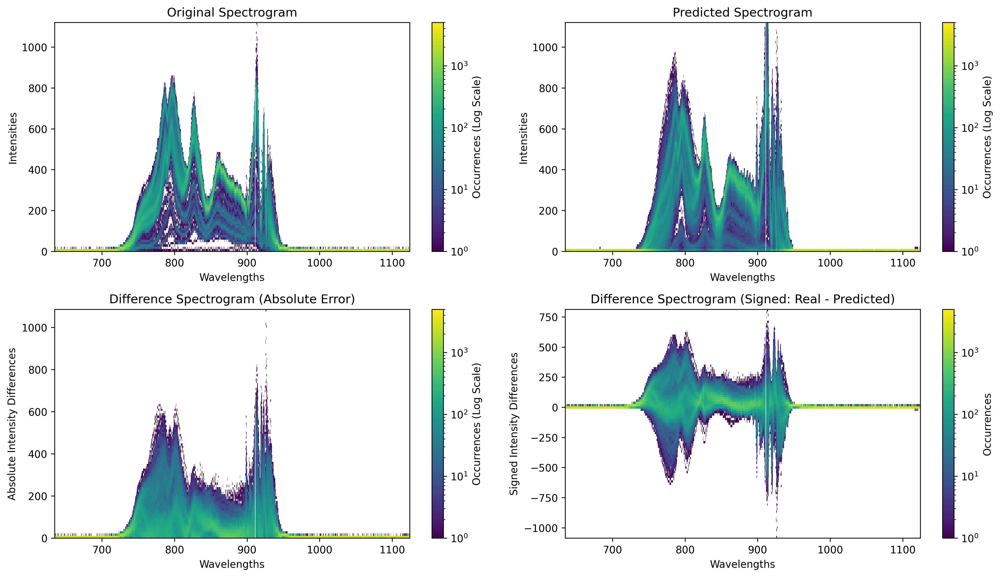

In [5]:
model_name = "ddim_bs16_do0_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "ddim"

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

# Run evaluation
x_real, cond_vectors, predictions = evaluate(
    device="cuda:0",
    test_csv_path=test_csv_path,
    model_path=model_path,
    n_samples=1,
    s_type=s_type,
    cfg_scale=3,
    noise_steps=1000,
)

# Save predictions
predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg3.csv")
save_predictions(x_real, cond_vectors, predictions, predictions_path)

# Compute metrics
calculate_metrics(x_real, predictions)

create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
create_combined_spectrogram(wavelengths, 
                        x_real, 
                        predictions)


==== Evaluating model: ddim_bs16_do20_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999 (ddim) ====


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [25:19<00:00,  1.64it/s]


Predictions saved to predictions/ddim_bs16_do20_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg3.csv
MSE error: 5844.752930
Mean Wasserstein Distance: 31.692671
Mean DTW Distance: 16996.498633


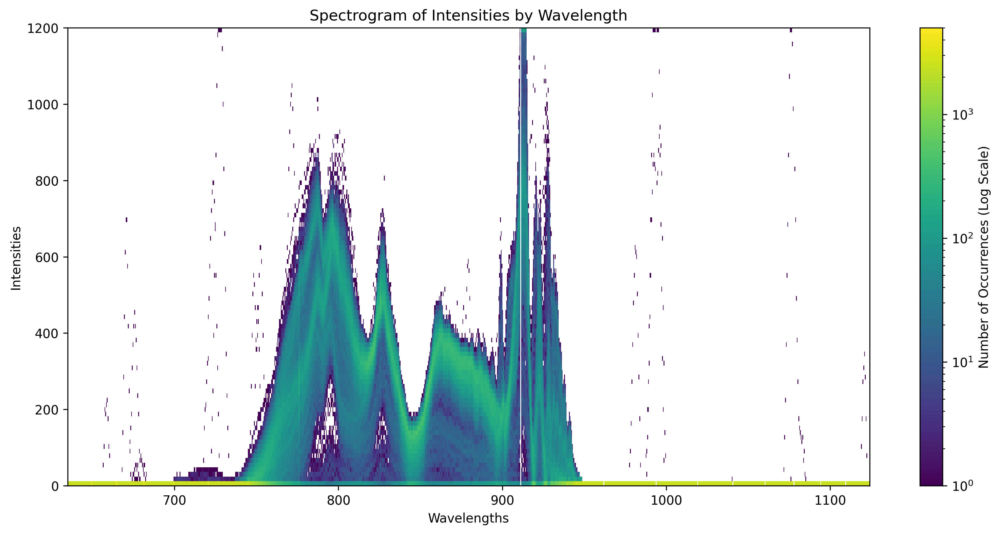

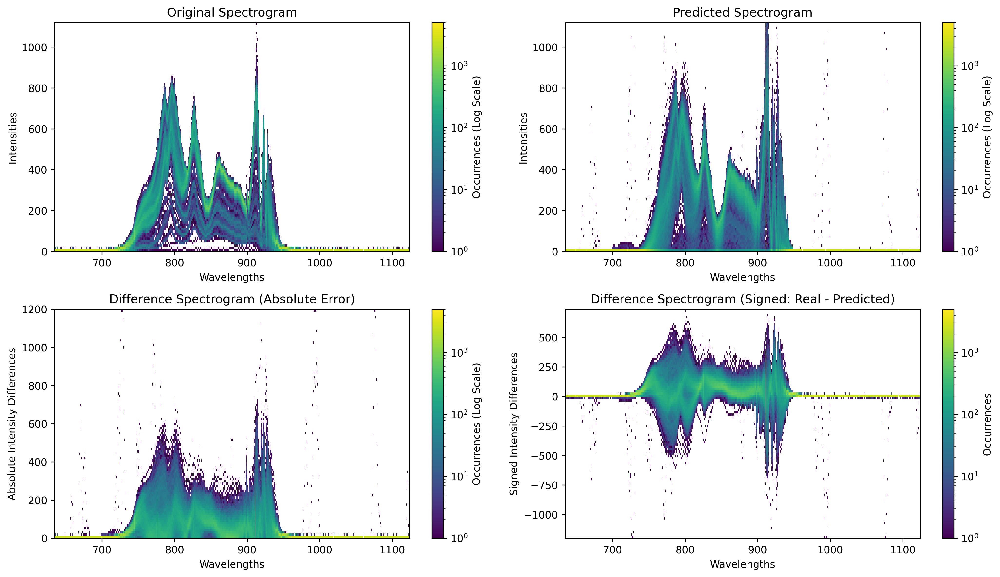

In [6]:
model_name = "ddim_bs16_do20_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "ddim"

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

# Run evaluation
x_real, cond_vectors, predictions = evaluate(
    device="cuda:0",
    test_csv_path=test_csv_path,
    model_path=model_path,
    n_samples=1,
    s_type=s_type,
    cfg_scale=3,
    noise_steps=1000,
)

# Save predictions
predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg3.csv")
save_predictions(x_real, cond_vectors, predictions, predictions_path)

# Compute metrics
calculate_metrics(x_real, predictions)

create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
create_combined_spectrogram(wavelengths, 
                        x_real, 
                        predictions)

### CFG scale


==== Evaluating model: ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999 (ddim) ====

--> CFG Scale: 0


Testing loop: 100%|███████████████████████████████████████| 2500/2500 [13:31<00:00,  3.08it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg0.csv
MSE error: 4603.231445
Mean Wasserstein Distance: 24.890936
Mean DTW Distance: 14808.391052


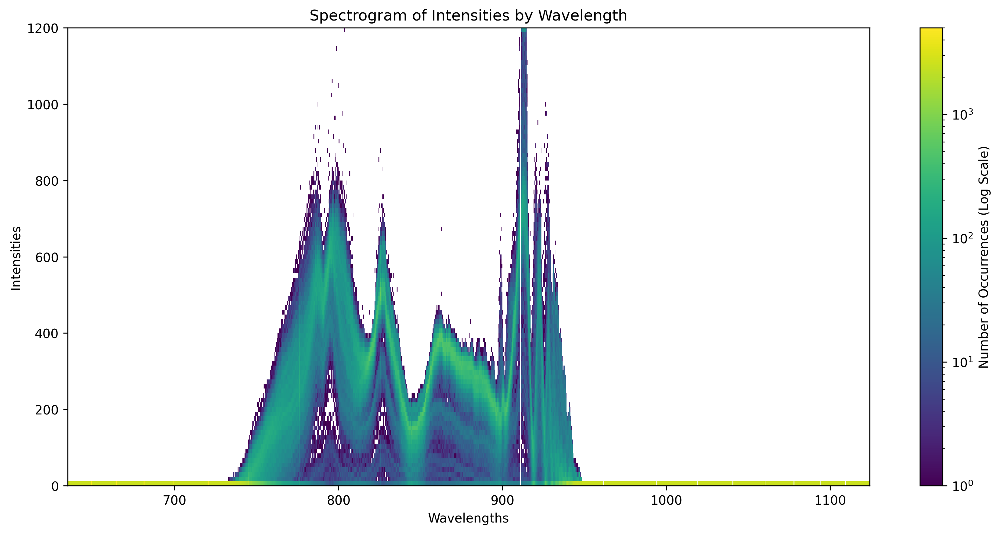

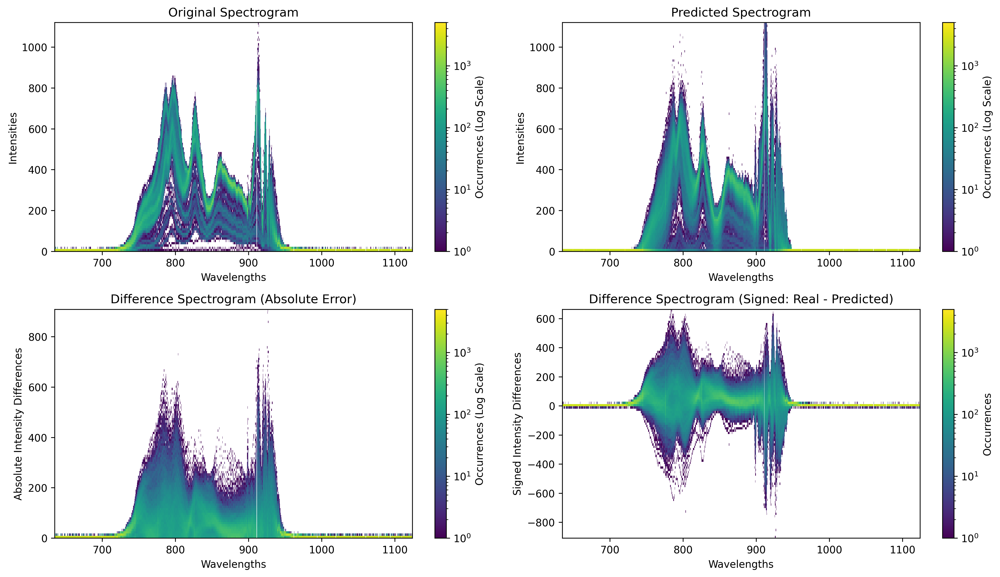


--> CFG Scale: 1


Testing loop: 100%|███████████████████████████████████████| 2500/2500 [25:34<00:00,  1.63it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg1.csv
MSE error: 4474.055664
Mean Wasserstein Distance: 24.872214
Mean DTW Distance: 14547.536790


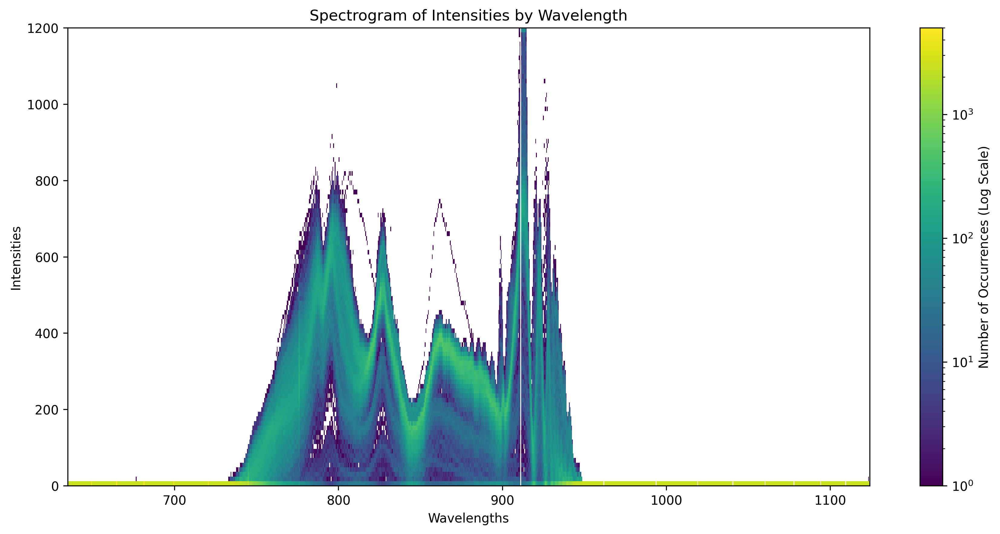

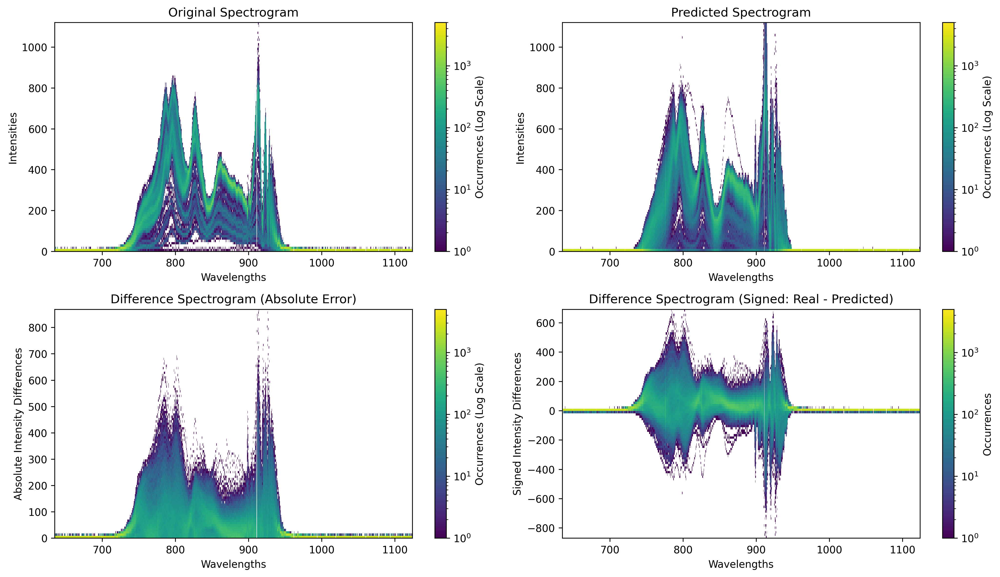


--> CFG Scale: 2


Testing loop: 100%|███████████████████████████████████████| 2500/2500 [25:36<00:00,  1.63it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg2.csv
MSE error: 4769.089844
Mean Wasserstein Distance: 24.921877
Mean DTW Distance: 14511.249717


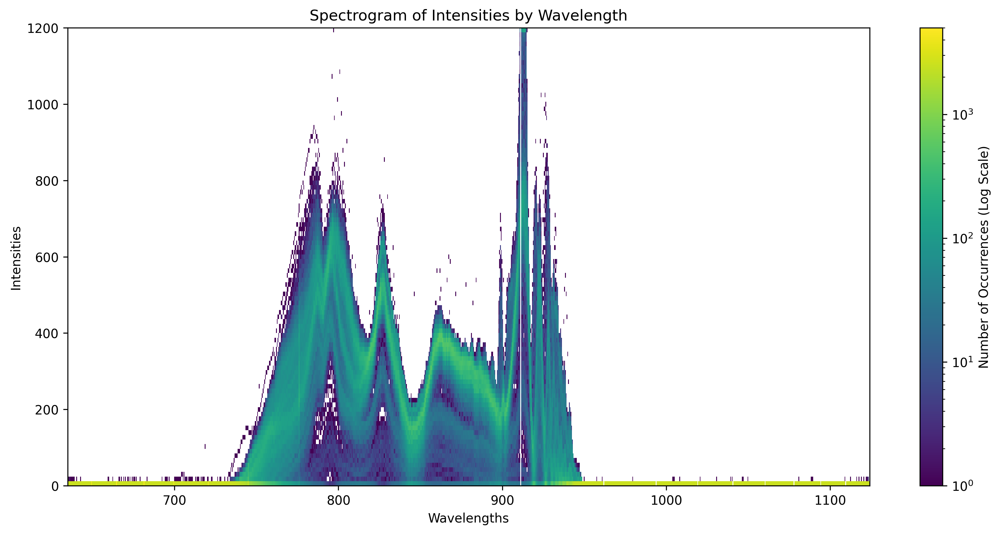

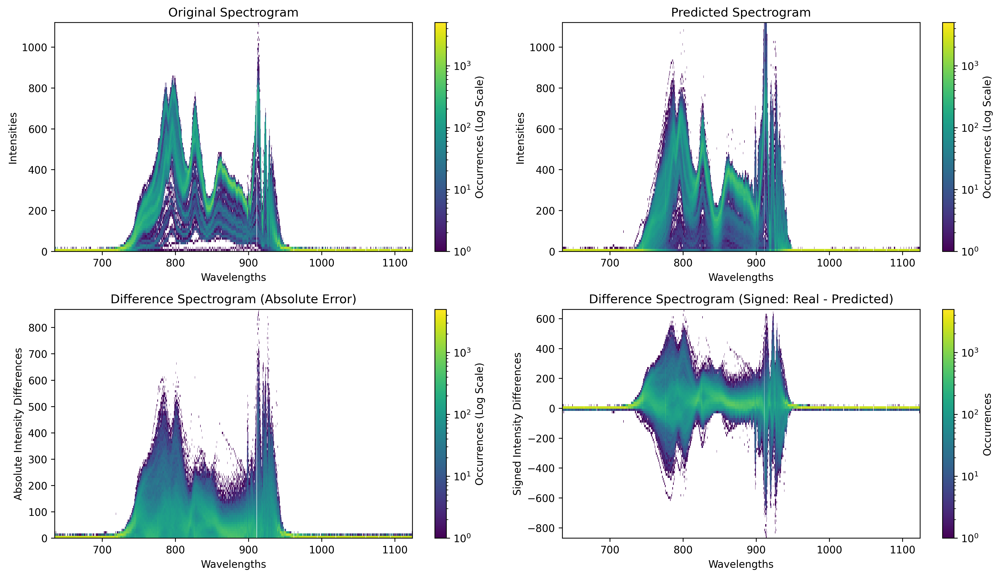


--> CFG Scale: 3


Testing loop: 100%|███████████████████████████████████████| 2500/2500 [25:29<00:00,  1.63it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg3.csv
MSE error: 5106.818359
Mean Wasserstein Distance: 25.347020
Mean DTW Distance: 14719.361140


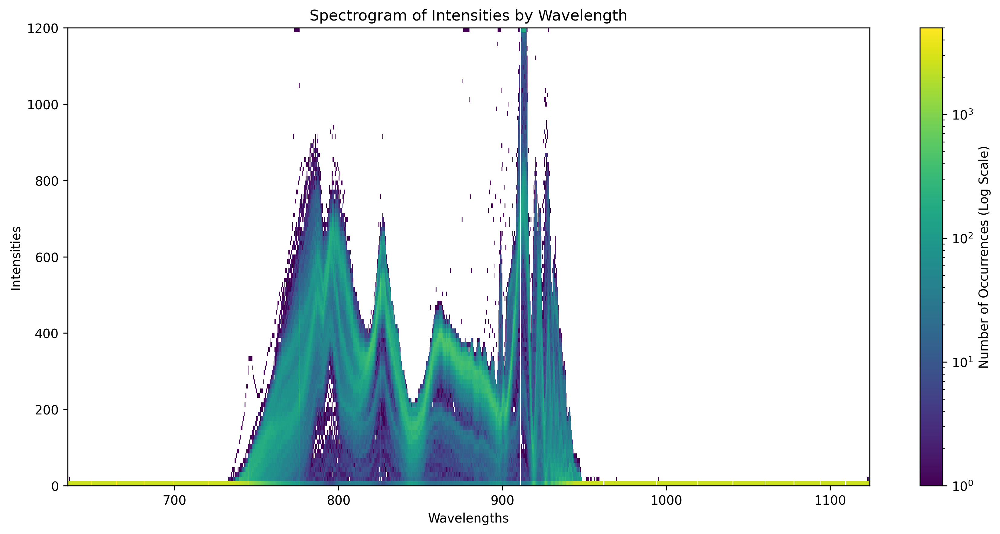

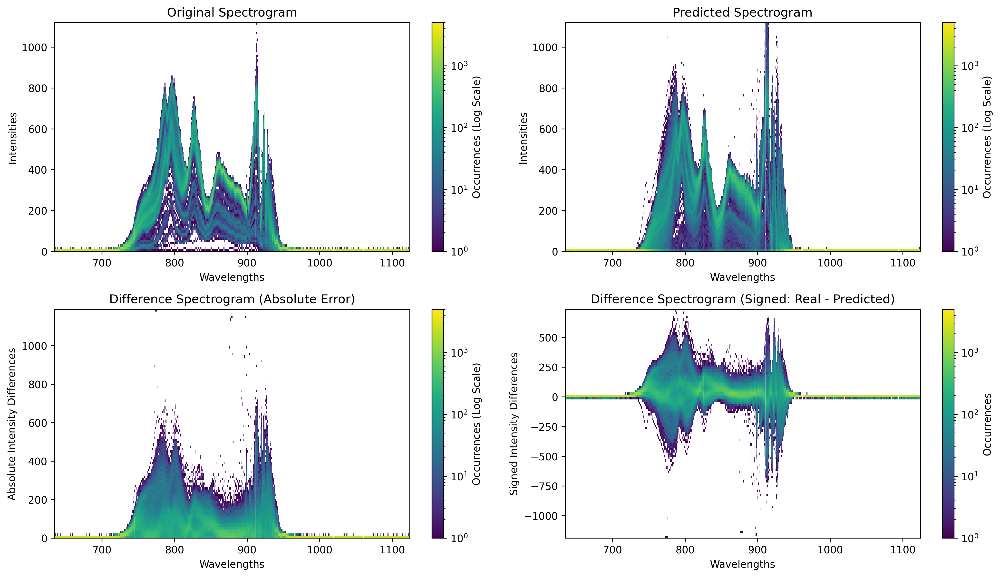


--> CFG Scale: 4


Testing loop: 100%|███████████████████████████████████████| 2500/2500 [27:05<00:00,  1.54it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg4.csv
MSE error: 5332.728027
Mean Wasserstein Distance: 25.042028
Mean DTW Distance: 14800.274251


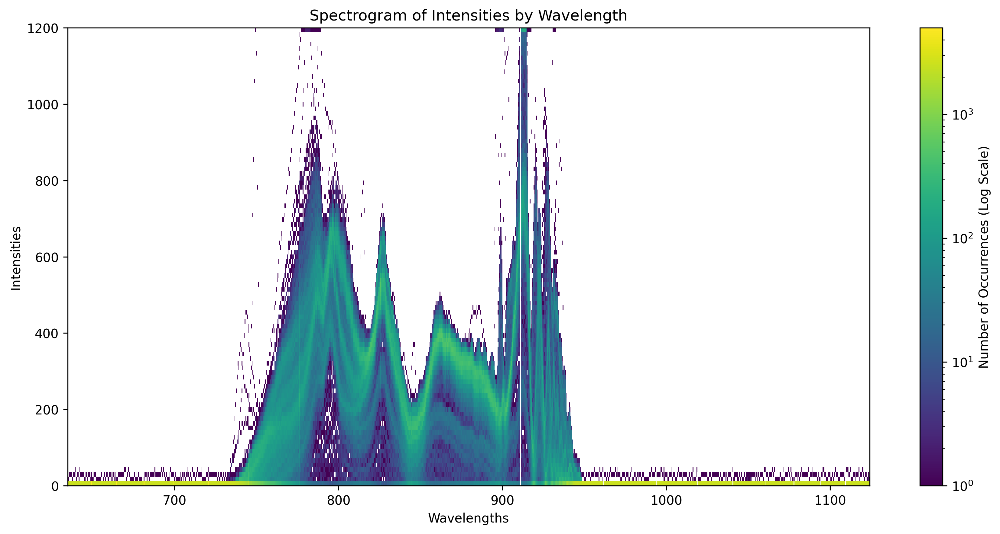

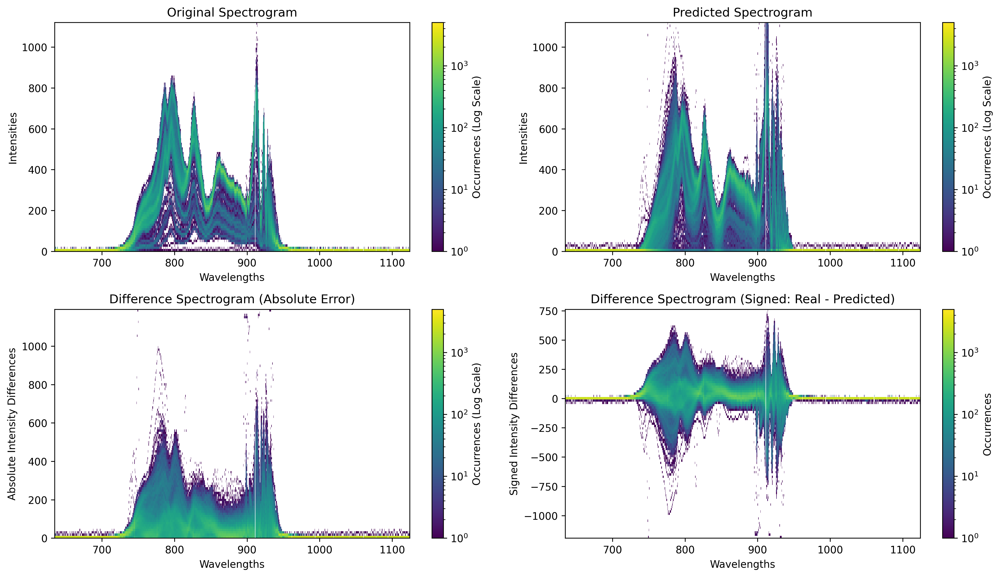

In [5]:
model_name = "ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "ddim"
cfg_scales = [0, 1, 2, 3, 4]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for cfg_scale in cfg_scales:
    print(f"\n--> CFG Scale: {cfg_scale}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=cfg_scale,
        noise_steps=1000,
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg{cfg_scale}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)

### Section counts


==== Evaluating model: ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999 (ddim) ====

--> section_counts: 20


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [12:40<00:00,  3.29it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg2_sc20.csv
MSE error: 4518.029785
Mean Wasserstein Distance: 24.168123
Mean DTW Distance: 14276.849659


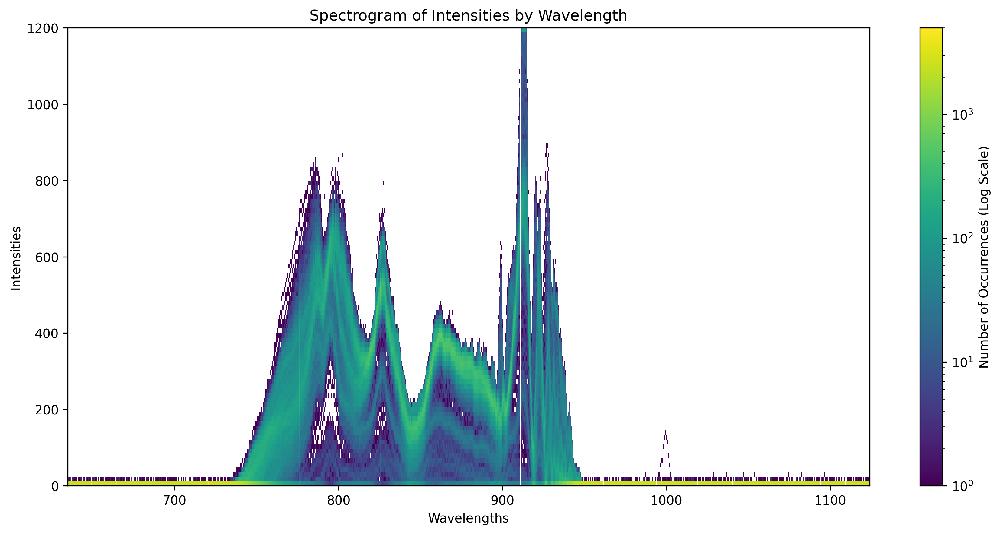

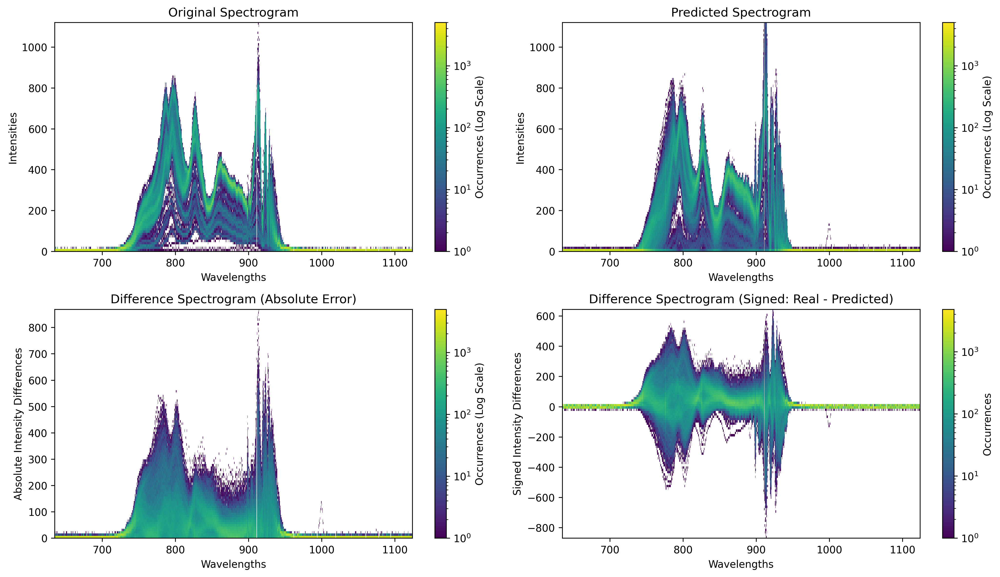


--> section_counts: 40


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [31:18<00:00,  1.33it/s]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg2_sc40.csv
MSE error: 4831.868164
Mean Wasserstein Distance: 25.800834
Mean DTW Distance: 14767.206064


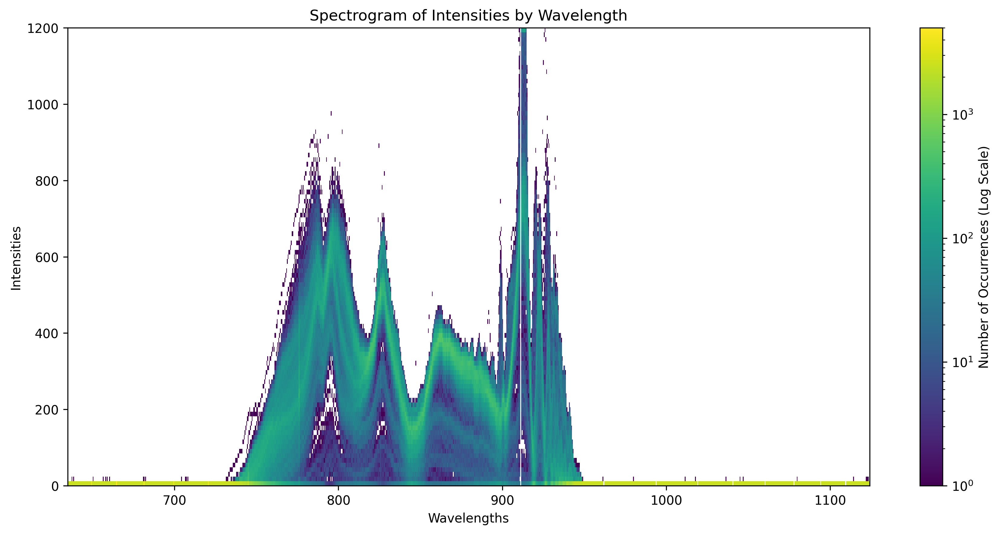

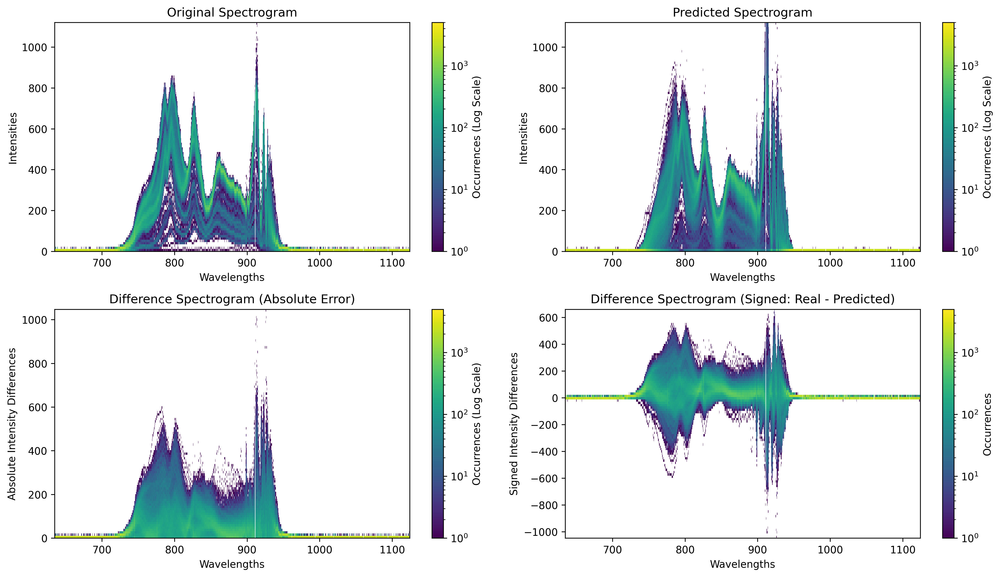


--> section_counts: 60


Testing loop:  11%|████                                  | 268/2500 [05:28<45:22,  1.22s/it]

In [ ]:
model_name = "ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "ddim"
section_counts = [20, 40, 60]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for sc in section_counts:
    print(f"\n--> section_counts: {sc}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=2,
        noise_steps=1000,
        section_counts=sc
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg2_sc{sc}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)


==== Evaluating model: ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999 (ddim) ====

--> section_counts: 60


Testing loop: 100%|█████████████████████████████████████| 2500/2500 [50:53<00:00,  1.22s/it]


Predictions saved to predictions/ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999/preds_epoch40_cfg2_sc60.csv
MSE error: 4883.902344
Mean Wasserstein Distance: 25.959302
Mean DTW Distance: 14780.697677


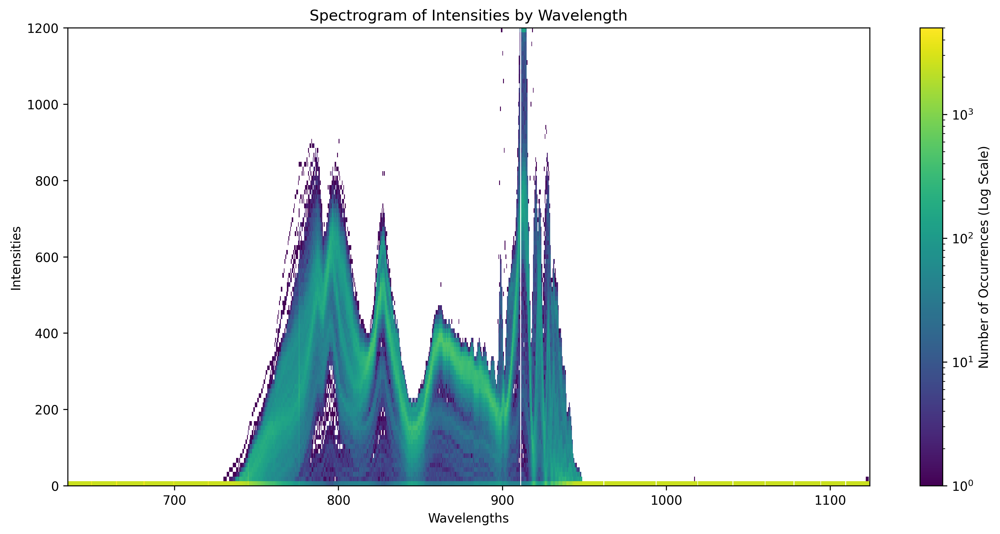

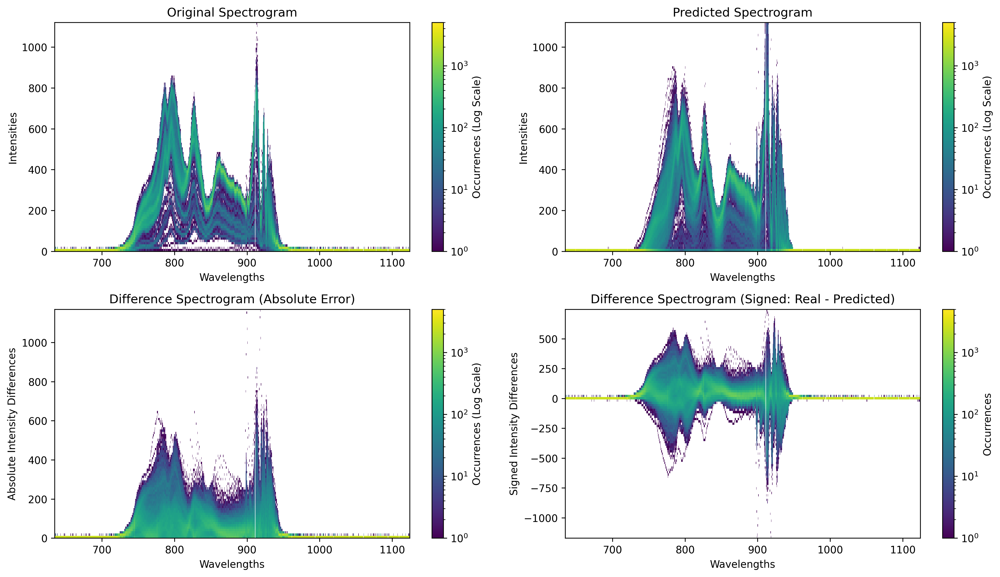

In [4]:
model_name = "ddim_bs16_do10_cgt10_cg3_ns1000_sc20_lr1e-3_0_e40_ed999"
epoch = 40
model_path = f"models/{model_name}/ema_ckpt{epoch}.pt"
s_type = "ddim"
section_counts = [60]

print(f"\n==== Evaluating model: {model_name} ({s_type}) ====")

for sc in section_counts:
    print(f"\n--> section_counts: {sc}")

    # Run evaluation
    x_real, cond_vectors, predictions = evaluate(
        device="cuda:0",
        test_csv_path=test_csv_path,
        model_path=model_path,
        n_samples=1,
        s_type=s_type,
        cfg_scale=2,
        noise_steps=1000,
        section_counts=sc
    )

    # Save predictions
    predictions_path = os.path.join("predictions", model_name, f"preds_epoch{epoch}_cfg2_sc{sc}.csv")
    save_predictions(x_real, cond_vectors, predictions, predictions_path)

    # Compute metrics
    calculate_metrics(x_real, predictions)

    create_spectrogram(wavelengths, predictions, label="Spectrogram of Intensities by Wavelength")
    create_combined_spectrogram(wavelengths, 
                            x_real, 
                            predictions)